# **Spotify Recommendation System**

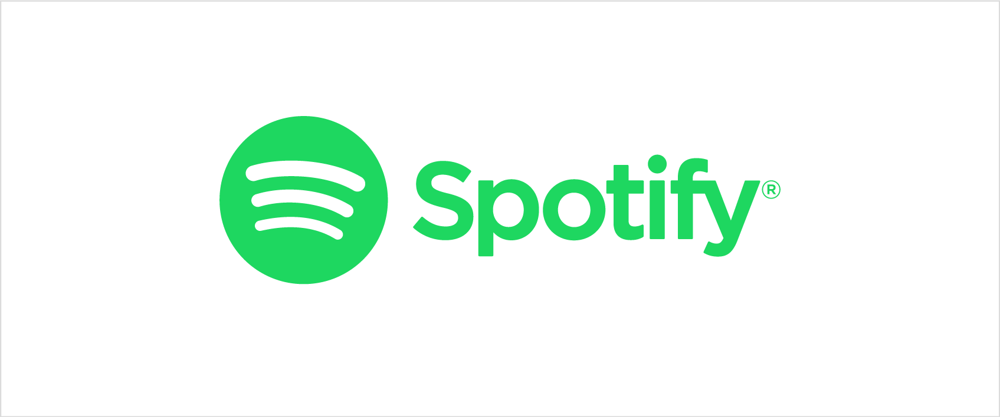

# **Sai Raghavendra Viravalli - 001568587**
# **Sai Saketh Vootla**

**Aim:**

We are doing analysis on the specified metrics and characteristics of the music using the Spotify dataset, including its popularity, the year it was published, and its liveness and danceability scores. After analysis, we may use clustering methods like k-means clustering to create different groups of several songs. By utilizing filtering methods like content-based filtering, we want to create a music recommendation system that uses the Spotify api to provide the most accurate song recommendations. It is obvious that adding song attributes in some way would increase the precision of our suggestions, therefore we will also need to figure out the best way to make use of these features.

### **Importing Libraries**

In [229]:
import os
import numpy as np
import pandas as pd

import seaborn as sns
import plotly.express as px 
import matplotlib.pyplot as plt
%matplotlib inline

from sklearn.cluster import KMeans
from sklearn.preprocessing import StandardScaler
from sklearn.pipeline import Pipeline
from sklearn.manifold import TSNE
from sklearn.decomposition import PCA
from sklearn.metrics import euclidean_distances
from scipy.spatial.distance import cdist
from sklearn.feature_extraction.text import CountVectorizer
from sklearn.metrics.pairwise import cosine_similarity
from sklearn.ensemble import RandomForestClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import train_test_split, GridSearchCV
from sklearn.metrics import precision_score, recall_score, accuracy_score, f1_score, confusion_matrix, roc_curve, auc, classification_report, roc_auc_score, plot_confusion_matrix, make_scorer
from sklearn.neighbors import KNeighborsClassifier
from sklearn.ensemble import GradientBoostingClassifier
from imblearn.over_sampling import SMOTE
from imblearn.pipeline import make_pipeline
import scipy.cluster.hierarchy as shc
from sklearn.cluster import AgglomerativeClustering

# **Dataset**

The Spotify Dataset offers ubiquitous database of songs and their features. The dataset has 170,653 number of rows and 20 columns. Each row in the dataset represents a song and its charectersitcs like who is the artist, in which year was the song realeased, how popular was the song, what is key feature of the song such as energy, liveness, danceability, speecheness, etc. All the individual features have given a short description below

The dataset splits into 170653 rows and 19 columns. Those 19 data columns are divided into 13 numerical and 6 categorical columns.

**Numerical columns:**


**acousticness:** The relative metric of the track being acoustic, (Ranges from 0 to 1)

**danceability:** The relative measurement of the track being danceable, (Ranges from 0 to 1)

**energy:** The energy of the track, (Ranges from 0 to 1)

**duration_ms:** The length of the track in milliseconds (ms), (Integer typically ranging from 5k to 300k)

**instrumentalness:**, The relative ratio of the track being instrumental, (Ranges from 0 to 1)

**valence:** The positiveness of the track, (Ranges from 0 to 1)

**popularity:** The popularity of the song lately, default country = US, (Ranges from 0 to 100)

**tempo:** The tempo of the track in Beat Per Minute (BPM), (Float typically ranging from 0 to 250)

**liveness:** The relative duration of the track sounding as a live performance, (Ranges from 0 to 1)

**loudness:** Relative loudness of the track in decibel (dB), (Float typically ranging from -60 to 4.0)

**speechiness:** The relative length of the track containing any kind of human voice, (Ranges from 0 to 1)

**year:** The release year of track, (Ranges from 1921 to 2020)

**id:** The primary identifier for the track, generated by Spotify


**categorical columns:**

**key:** The primary key of the track encoded as integers in between 0 and 11 (starting on C as 0, C# as 1 and so on…)

**artists:** The list of artists credited for production of the track

**release_date:** Date of release mostly in yyyy-mm-dd format, however precision of date may vary

**name:** The title of the track

**mode:** The binary value representing whether the track starts with a major (1) chord progression or a minor (0)

**explicit:** The binary value whether the track contains explicit content or not, (0 = No explicit content, 1 = Explicit content)

### **Reading the Data**

In [230]:
data = pd.read_csv("https://raw.githubusercontent.com/Sairaghav1999/INFO7390-Advanced-Data-Science-Architecture/main/Dataset/data.csv")
genre_data = pd.read_csv('https://raw.githubusercontent.com/Sairaghav1999/INFO7390-Advanced-Data-Science-Architecture/main/Dataset/data_by_genres.csv')
year_data = pd.read_csv('https://raw.githubusercontent.com/Sairaghav1999/INFO7390-Advanced-Data-Science-Architecture/main/Dataset/data_by_year.csv')
artist_data= pd. read_csv('https://raw.githubusercontent.com/Sairaghav1999/INFO7390-Dataset/main/data_by_artist.csv')

In [231]:
year_data.head(100)

,mode,year,acousticness,danceability,duration_ms,energy,instrumentalness,liveness,loudness,speechiness,tempo,valence,popularity,key
0,1,1921,0.886896,0.418597,260537.166667,0.231815,0.344878,0.205710,-17.048667,0.073662,101.531493,0.379327,0.653333,2
1,1,1922,0.938592,0.482042,165469.746479,0.237815,0.434195,0.240720,-19.275282,0.116655,100.884521,0.535549,0.140845,10
2,1,1923,0.957247,0.577341,177942.362162,0.262406,0.371733,0.227462,-14.129211,0.093949,114.010730,0.625492,5.389189,0
3,1,1924,0.940200,0.549894,191046.707627,0.344347,0.581701,0.235219,-14.231343,0.092089,120.689572,0.663725,0.661017,10
4,1,1925,0.962607,0.573863,184986.924460,0.278594,0.418297,0.237668,-14.146414,0.111918,115.521921,0.621929,2.604317,5
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
95,1,2016,0.284171,0.600202,221396.510295,0.592855,0.093984,0.181170,-8.061056,0.104313,118.652630,0.431532,59.647190,0
96,1,2017,0.286099,0.612217,211115.696787,0.590421,0.097091,0.191713,-8.312630,0.110536,117.202740,0.416476,63.263554,1
97,1,2018,0.267633,0.663500,206001.007133,0.602435,0.054217,0.176326,-7.168785,0.127176,121.922308,0.447921,63.296243,1
98,1,2019,0.278299,0.644814,201024.788096,0.593224,0.077640,0.172616,-7.722192,0.121043,120.235644,0.458818,65.256542,1


In [232]:
data.head()

,valence,year,acousticness,artists,danceability,duration_ms,energy,explicit,id,instrumentalness,key,liveness,loudness,mode,name,popularity,release_date,speechiness,tempo
0,0.0594,1921,0.982,"['Sergei Rachmaninoff', 'James Levine', 'Berli...",0.279,831667,0.211,0,4BJqT0PrAfrxzMOxytFOIz,0.878000,10,0.665,-20.096,1,"Piano Concerto No. 3 in D Minor, Op. 30: III. ...",4,1921,0.0366,80.954
1,0.9630,1921,0.732,['Dennis Day'],0.819,180533,0.341,0,7xPhfUan2yNtyFG0cUWkt8,0.000000,7,0.160,-12.441,1,Clancy Lowered the Boom,5,1921,0.4150,60.936
2,0.0394,1921,0.961,['KHP Kridhamardawa Karaton Ngayogyakarta Hadi...,0.328,500062,0.166,0,1o6I8BglA6ylDMrIELygv1,0.913000,3,0.101,-14.850,1,Gati Bali,5,1921,0.0339,110.339
3,0.1650,1921,0.967,['Frank Parker'],0.275,210000,0.309,0,3ftBPsC5vPBKxYSee08FDH,0.000028,5,0.381,-9.316,1,Danny Boy,3,1921,0.0354,100.109
4,0.2530,1921,0.957,['Phil Regan'],0.418,166693,0.193,0,4d6HGyGT8e121BsdKmw9v6,0.000002,3,0.229,-10.096,1,When Irish Eyes Are Smiling,2,1921,0.0380,101.665


In [233]:
artist_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 28680 entries, 0 to 28679
Data columns (total 15 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   mode              28680 non-null  int64  
 1   count             28680 non-null  int64  
 2   acousticness      28680 non-null  float64
 3   artists           28680 non-null  object 
 4   danceability      28680 non-null  float64
 5   duration_ms       28680 non-null  float64
 6   energy            28680 non-null  float64
 7   instrumentalness  28680 non-null  float64
 8   liveness          28680 non-null  float64
 9   loudness          28680 non-null  float64
 10  speechiness       28680 non-null  float64
 11  tempo             28680 non-null  float64
 12  valence           28680 non-null  float64
 13  popularity        28680 non-null  float64
 14  key               28680 non-null  int64  
dtypes: float64(11), int64(3), object(1)
memory usage: 3.3+ MB


### **Data Preprocessing**

**NaN values:** There are no real NaN values

**Dropping Rows:** 
However, there are songs with zero tempo but with a relatively high popularity in some cases. This subset is identical to subsets with 0 danceability and 0 speechiness. It was found out that those 'zero tempo songs' are not real songs but noises or sounds. They are highly popular because they seem to have a positive effect on a restful sleep or for relaxation. 

**Dropping Columns:**

**id:** It splits into 170653 unique entires. This is the number of rows in the dataset. This column can be removed from the dataset.

**name:** This text value has too less power for a popularity prediction. There are 133638 unique entries (78% of the dataframe). There are some dublicates, but too less, to justify its transformation to dummy variables.

**release-date:** As it can be already seen from the min and max values in the descriptive statistics table there is some mixture in the datetime formats. 

It can be ignored as the focus relies on a yearly based analysis. This information is already provided in the 'year' column.


Cleaning the data by removing duplicates if present any

In [234]:
# Drop song duplicates
def drop_duplicates(df):
    '''
    Drop duplicate songs
    '''
    df['artists_song'] = df.apply(lambda row: row['artists']+row['name'],axis = 1)
    return df.drop_duplicates('artists_song')

songDF = drop_duplicates(data)
print("Are all songs unique: ",len(pd.unique(songDF.artists_song))==len(songDF))

Are all songs unique:  True


There are no Duplicates in the dataset, so we can proceed ahead by checking if there are any Null values

Checking for Null values

In [235]:
data.isnull().sum()

valence             0
year                0
acousticness        0
artists             0
danceability        0
duration_ms         0
energy              0
explicit            0
id                  0
instrumentalness    0
key                 0
liveness            0
loudness            0
mode                0
name                0
popularity          0
release_date        0
speechiness         0
tempo               0
artists_song        0
dtype: int64

In [236]:
genre_data.isnull().sum()

mode                0
genres              0
acousticness        0
danceability        0
duration_ms         0
energy              0
instrumentalness    0
liveness            0
loudness            0
speechiness         0
tempo               0
valence             0
popularity          0
key                 0
dtype: int64

In [237]:
year_data.isnull().sum()

mode                0
year                0
acousticness        0
danceability        0
duration_ms         0
energy              0
instrumentalness    0
liveness            0
loudness            0
speechiness         0
tempo               0
valence             0
popularity          0
key                 0
dtype: int64

There are no Null values present too, we can proceed with analyzing of data by performing EDA and Visualization

# **Descreptive Statistics of the Data**

In [238]:
data.describe().transpose()

,count,mean,std,min,25%,50%,75%,max
valence,170653.0,0.528587,0.263171,0.0,0.3170,0.540000,0.7470,1.000
year,170653.0,1976.787241,25.917853,1921.0,1956.0000,1977.000000,1999.0000,2020.000
acousticness,170653.0,0.502115,0.376032,0.0,0.1020,0.516000,0.8930,0.996
danceability,170653.0,0.537396,0.176138,0.0,0.4150,0.548000,0.6680,0.988
duration_ms,170653.0,230948.310666,126118.414668,5108.0,169827.0000,207467.000000,262400.0000,5403500.000
energy,170653.0,0.482389,0.267646,0.0,0.2550,0.471000,0.7030,1.000
explicit,170653.0,0.084575,0.278249,0.0,0.0000,0.000000,0.0000,1.000
instrumentalness,170653.0,0.167010,0.313475,0.0,0.0000,0.000216,0.1020,1.000
key,170653.0,5.199844,3.515094,0.0,2.0000,5.000000,8.0000,11.000
liveness,170653.0,0.205839,0.174805,0.0,0.0988,0.136000,0.2610,1.000


In [239]:
def get_prepared_df(df, cols_to_drop, target):
  
    col_drop_with_target = cols_to_drop.copy()
    col_drop_with_target.append(target)
    
    # list with dependent and independent variables
    xy_columns = df.drop(cols_to_drop, axis=1).columns.tolist()
    print('#### Dependent and independent variable set')
    print(xy_columns)

    # list with only independent variables
    x_columns = df.drop(col_drop_with_target, axis=1).columns.tolist()
    print('#### Only independent variables')
    print(x_columns)
    
    # data_cleaned = df with cols_to_drop removed
    data_cleaned = df.drop(cols_to_drop, axis=1)

    # Let's remove zero tempo (zero danceability and zero speechiness) rows
    data_cleaned = data_cleaned[data_cleaned['tempo'] !=0]
    print('#### New shape of prepared DataFrame')
    print(data_cleaned.shape)

    column_set = data_cleaned.columns.tolist()
    
    return data_cleaned, xy_columns, x_columns

In [240]:
# Get cleaned DataFrame with only numerical columns including the target column
data_cleaned, xy_columns, x_columns = get_prepared_df(data, ['id', 
                                                       'name', 
                                                       'release_date', 
                                                      ],
                                                       'popularity')

#### Dependent and independent variable set
['valence', 'year', 'acousticness', 'artists', 'danceability', 'duration_ms', 'energy', 'explicit', 'instrumentalness', 'key', 'liveness', 'loudness', 'mode', 'popularity', 'speechiness', 'tempo', 'artists_song']
#### Only independent variables
['valence', 'year', 'acousticness', 'artists', 'danceability', 'duration_ms', 'energy', 'explicit', 'instrumentalness', 'key', 'liveness', 'loudness', 'mode', 'speechiness', 'tempo', 'artists_song']
#### New shape of prepared DataFrame
(170510, 17)


### ***Exploratory Data Analytics***

Looking at a sample of the data

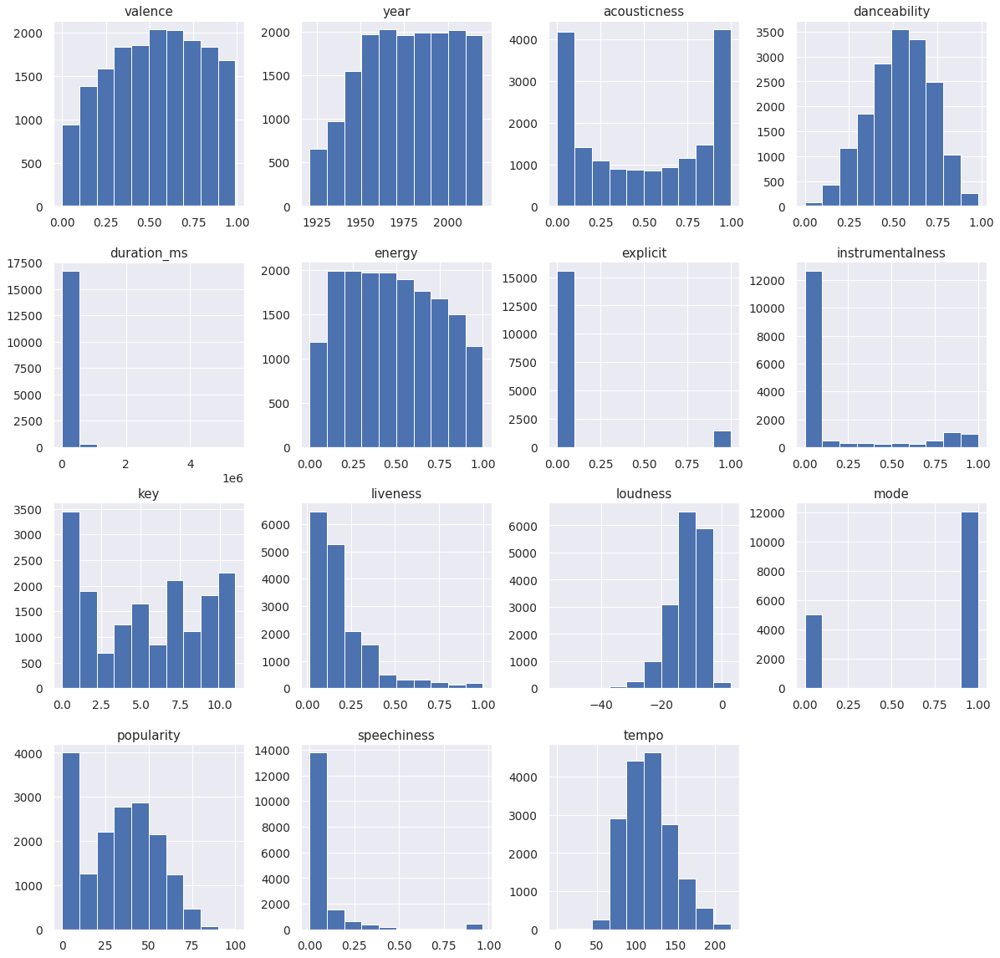

In [241]:
dataset = data.sample(frac=0.1, random_state = 1)
# Plot histograms of each parameter 
dataset.hist(figsize = (20, 20))
plt.show()

Creating a sub dataframe for most popular songs over the years and plotting graphs against the liveliness, energy, danceability and spechness for the most popular songs

In [242]:
df_sort = year_data.iloc[::9]
sorted_pop_df=data.sort_values("popularity",ascending=False)

In [243]:
most_popular=sorted_pop_df[sorted_pop_df["popularity"]>90].sort_values(by="popularity",ascending=False)
most_popular.head()

,valence,year,acousticness,artists,danceability,duration_ms,energy,explicit,id,instrumentalness,key,liveness,loudness,mode,name,popularity,release_date,speechiness,tempo,artists_song
19611,0.145,2020,0.4010,"['Bad Bunny', 'Jhay Cortez']",0.731,205090,0.573,1,47EiUVwUp4C9fGccaPuUCS,0.000052,4,0.1130,-10.059,0,Dakiti,100,2020-10-30,0.0544,109.928,"['Bad Bunny', 'Jhay Cortez']Dakiti"
19606,0.756,2020,0.2210,"['24kGoldn', 'iann dior']",0.700,140526,0.722,1,3tjFYV6RSFtuktYl3ZtYcq,0.000000,7,0.2720,-3.558,0,Mood (feat. iann dior),99,2020-07-24,0.0369,90.989,"['24kGoldn', 'iann dior']Mood (feat. iann dior)"
19618,0.737,2020,0.0112,['BTS'],0.746,199054,0.765,0,0t1kP63rueHleOhQkYSXFY,0.000000,6,0.0936,-4.410,0,Dynamite,97,2020-08-28,0.0993,114.044,['BTS']Dynamite
19608,0.357,2020,0.0194,"['Cardi B', 'Megan Thee Stallion']",0.935,187541,0.454,1,4Oun2ylbjFKMPTiaSbbCih,0.000000,1,0.0824,-7.509,1,WAP (feat. Megan Thee Stallion),96,2020-08-07,0.3750,133.073,"['Cardi B', 'Megan Thee Stallion']WAP (feat. M..."
19610,0.682,2020,0.4680,['Ariana Grande'],0.737,172325,0.802,1,35mvY5S1H3J2QZyna3TFe0,0.000000,0,0.0931,-4.771,1,positions,96,2020-10-30,0.0878,144.015,['Ariana Grande']positions


We are going to verify that every analysis has **"popularity"** as its aim. Prior to doing that, let's examine a few features to see if there is any feature correlation.

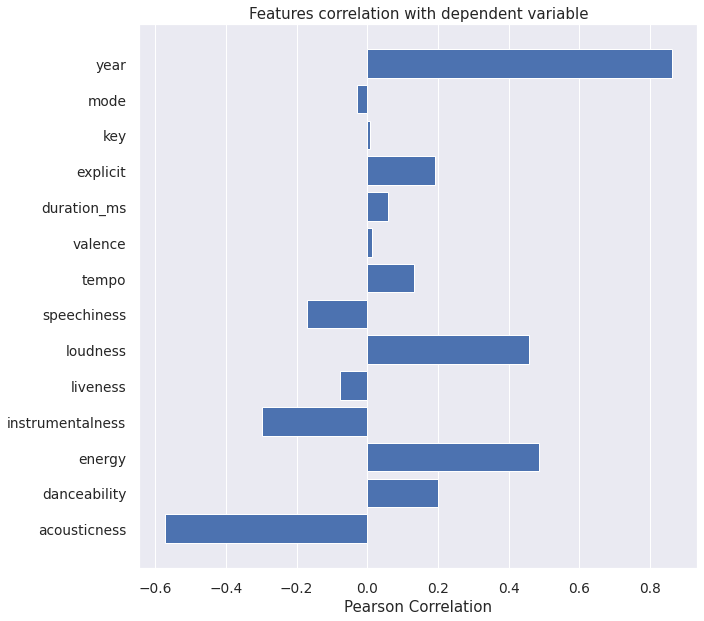

In [244]:
from yellowbrick.target import FeatureCorrelation

feature_names = ['acousticness', 'danceability', 'energy', 'instrumentalness',
       'liveness', 'loudness', 'speechiness', 'tempo', 'valence','duration_ms','explicit','key','mode','year']

X, y = data[feature_names], data['popularity']

# Create a list of the feature names
features = np.array(feature_names)

# Instantiate the visualizer
visualizer = FeatureCorrelation(labels=features)

plt.rcParams['figure.figsize']=(10,10)
visualizer.fit(X, y)     # Fit the data to the visualizer
visualizer.show()

Looking at the co-relation between all the features in the dataset, We can observe that the features loudness and energy are most correlated along with acoustics and energy being the least correlated with each other

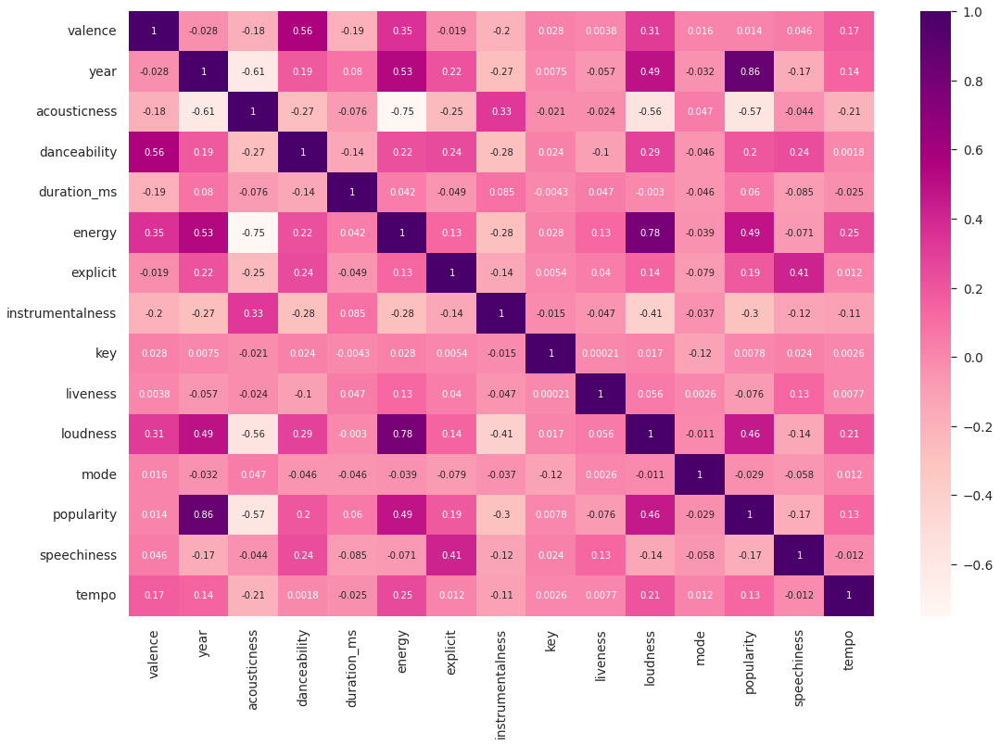

In [245]:
plt.subplots(figsize=(18, 12))
sns.heatmap(data.corr(), cmap="RdPu", annot = True, )

By looking at the Correlation we can Depict that there are Negetive and Postive correatlation and influence

**Negative influence on song popularity for**

acousticness: correlated also negatively with loudness, energy and danceability and year

instrumentalness: similar (but less signal) to acousticness correlates also negatively with loudness, energy and danceability and year)

**Positive influence on song popularity for**

year

energy

loudness

danceability

The correlation with duration_ms, valence, key, mode and liveness is weak. Some kind (but minor) correlation can be observed for explicit, tempo - positive - and for speechness - negative.

Creating a word cloud for all the geners which were categorized from 1921 - 2020

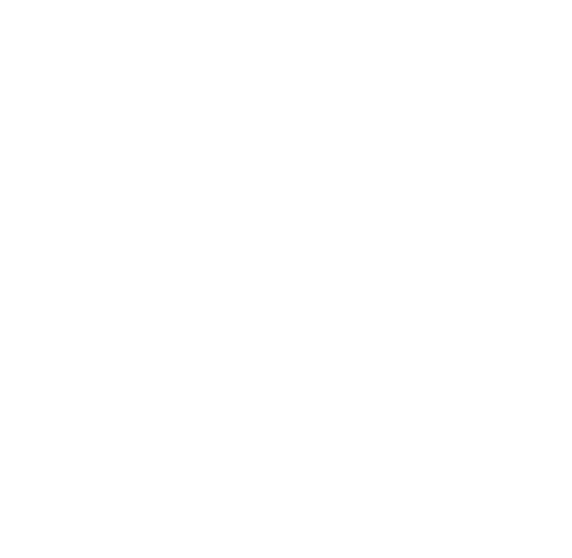

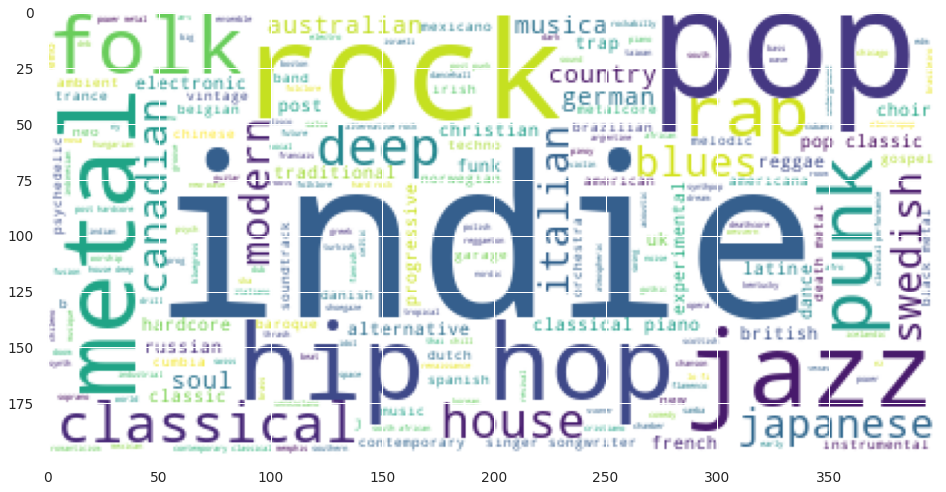

In [246]:
from wordcloud import WordCloud
# Text from "genre" column in genres data
genre_text = ' '.join(genre for genre in genre_data.genres.astype(str))

# Generate wordcloud using text
wc = WordCloud(background_color="white")
wordcloud = wc.generate(genre_text)

# Display wordcloud
plt.axis('off')
plt.figure(figsize=(16, 10))
plt.imshow(wordcloud)
plt.show()

To identify the largest geners we create a sub dataframe and to understand the behaviour of a feature in a specific set of songs categorized under one genre

In [247]:
top10_genres = genre_data.nlargest(15, 'popularity')

fig = px.bar(top10_genres, x='genres', y=['valence', 'energy', 'danceability', 'acousticness'], barmode='group')
fig.show()

Along with audio features for various genres, there are audio features for various songs. This knowledge allows us to compare various genres and comprehend the distinctive sonic contrasts between them.

In [248]:
spy_atr = ['valence', 'acousticness', 'danceability',
           'energy','instrumentalness', 'liveness', 'speechiness']

In [249]:
df_spider = data[spy_atr]

In [250]:
df_spider.iloc[4]

valence             0.253000
acousticness        0.957000
danceability        0.418000
energy              0.193000
instrumentalness    0.000002
liveness            0.229000
speechiness         0.038000
Name: 4, dtype: float64

We can comprehend how the general sound of music has changed from 1921 to 2020 by looking at the data sorted by year.

/usr/local/lib/python3.7/dist-packages/seaborn/_decorators.py:43: FutureWarning:

Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.



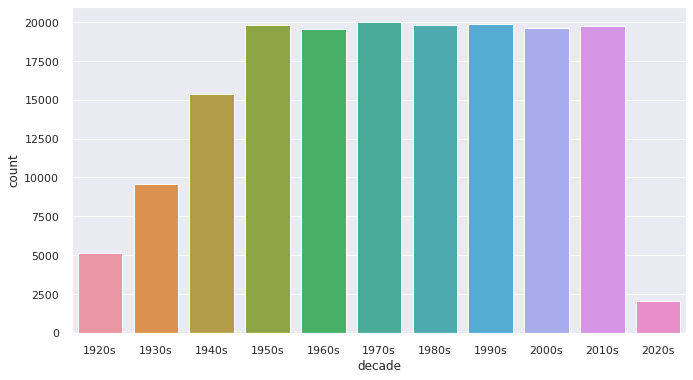

In [251]:
def get_decade(year):
    period_start = int(year/10) * 10
    decade = '{}s'.format(period_start)
    return decade

data['decade'] = data['year'].apply(get_decade)

sns.set(rc={'figure.figsize':(11 ,6)})
sns.countplot(data['decade'])

We will the analyze the top 10 popular songs in the dataset

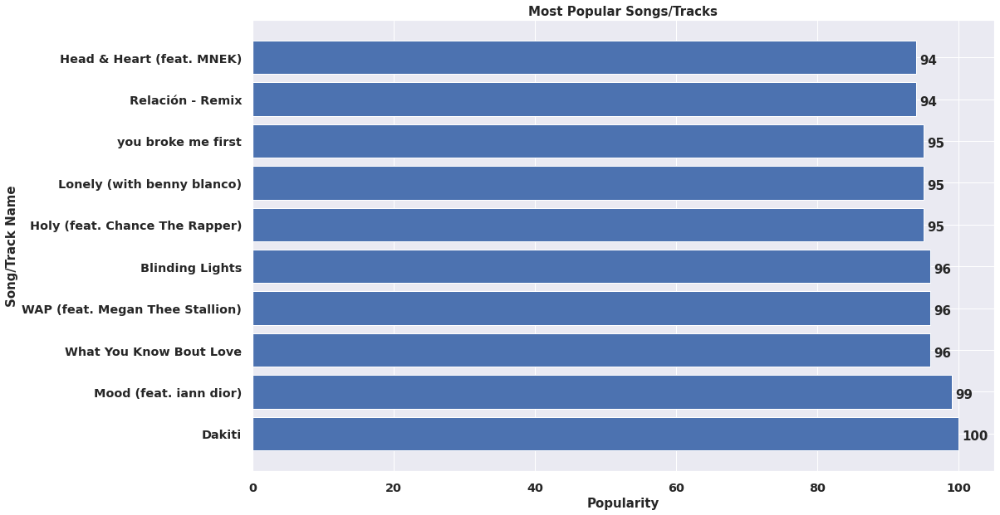

In [252]:
popular_songs = data.groupby('name')['popularity'].mean().sort_values(ascending=False).head(10)
plt.figure(figsize=(16, 10))
plt.barh(popular_songs.index, popular_songs)
plt.title('Most Popular Songs/Tracks', fontdict=dict(fontsize=15), fontweight='bold')
plt.xlabel('Popularity', fontdict=dict(fontsize=15), fontweight='bold')
plt.ylabel('Song/Track Name', fontdict=dict(fontsize=15), fontweight='bold')
plt.xticks(fontsize='large', weight='bold')
plt.yticks(fontsize='large', weight='bold')
for i, v in enumerate(popular_songs):
    plt.text(v+0.5, i-0.15, str(int(v)), fontdict=dict(fontsize=15), fontweight='bold')
plt.show()

We will the analyze the top 10 artists in the dataset

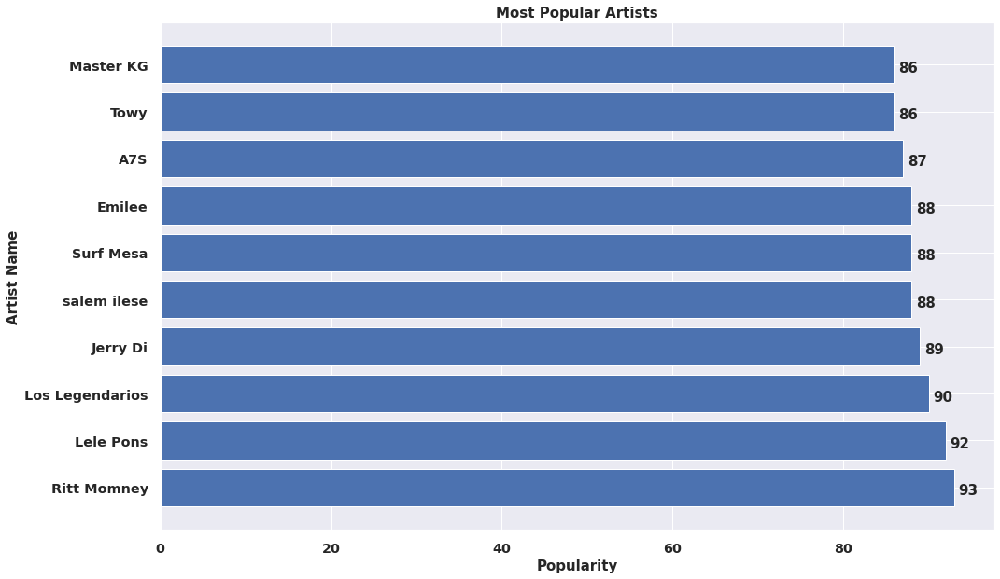

In [253]:
popular_artists = artist_data.groupby('artists')['popularity'].mean().sort_values(ascending=False).head(10)

# Plot horizontal bar chart
plt.figure(figsize=(16, 10))
plt.barh(popular_artists.index, popular_artists)
plt.title('Most Popular Artists', fontdict=dict(fontsize=15), fontweight='bold')
plt.xlabel('Popularity', fontdict=dict(fontsize=15), fontweight='bold')
plt.ylabel('Artist Name', fontdict=dict(fontsize=15), fontweight='bold')
plt.xticks(fontsize='large', weight='bold')
plt.yticks(fontsize='large', weight='bold')
for i, v in enumerate(popular_artists):
    plt.text(v+0.5, i-0.15, str(int(v)), fontdict=dict(fontsize=15), fontweight='bold')
plt.show()

We will the analyze the top 10 popular genres in the dataset

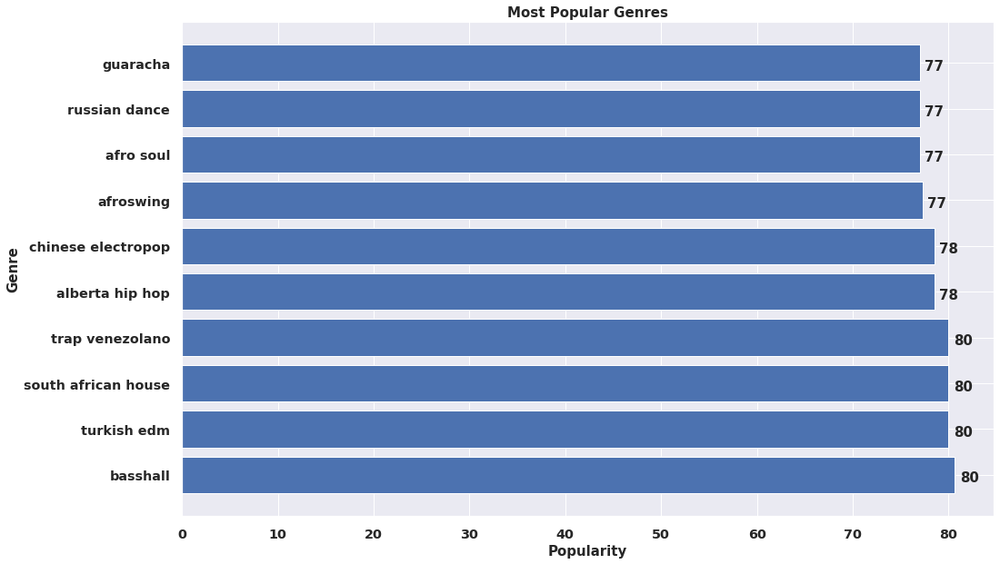

In [254]:
popular_genres = genre_data.groupby('genres')['popularity'].mean().sort_values(ascending=False).head(10)

# Plot horizontal bar chart
plt.figure(figsize=(16, 10))
plt.barh(popular_genres.index, popular_genres)
plt.title('Most Popular Genres', fontdict=dict(fontsize=15), fontweight='bold')
plt.xlabel('Popularity', fontdict=dict(fontsize=15), fontweight='bold')
plt.ylabel('Genre', fontdict=dict(fontsize=15), fontweight='bold')
plt.xticks(fontsize='large', weight='bold')
plt.yticks(fontsize='large', weight='bold')
for i, v in enumerate(popular_genres):
    plt.text(v+0.5, i-0.15, str(int(v)), fontdict=dict(fontsize=15), fontweight='bold')
plt.show()

We can depict the charecterstics of the most popular songs by looking at the plot understanding the different features of the song

In [255]:
sound_features = ['acousticness', 'danceability', 'energy', 'instrumentalness', 'liveness', 'valence']
fig = px.line(year_data, x='year', y=sound_features)
fig.show()

We get the details about our dataset before we continue with the modelling

In [257]:
data.describe(include="O")

,artists,id,name,release_date,artists_song,decade
count,170653,170653,170653,170653,170653,170653
unique,34088,170653,133638,11244,157685,11
top,['Эрнест Хемингуэй'],4BJqT0PrAfrxzMOxytFOIz,White Christmas,1945,['KAROL G']A Ella,1970s
freq,1211,1,73,1446,11,20000


As popularity wont be a metric in our analysis and not part of the feature we remove it from the dataset

In [261]:
df = data.drop(['popularity'], axis=1)
df

,valence,year,acousticness,artists,danceability,duration_ms,energy,explicit,id,instrumentalness,key,liveness,loudness,mode,name,release_date,speechiness,tempo,artists_song,decade
0,0.0594,1921,0.98200,"['Sergei Rachmaninoff', 'James Levine', 'Berli...",0.279,831667,0.211,0,4BJqT0PrAfrxzMOxytFOIz,0.878000,10,0.6650,-20.096,1,"Piano Concerto No. 3 in D Minor, Op. 30: III. ...",1921,0.0366,80.954,"['Sergei Rachmaninoff', 'James Levine', 'Berli...",1920s
1,0.9630,1921,0.73200,['Dennis Day'],0.819,180533,0.341,0,7xPhfUan2yNtyFG0cUWkt8,0.000000,7,0.1600,-12.441,1,Clancy Lowered the Boom,1921,0.4150,60.936,['Dennis Day']Clancy Lowered the Boom,1920s
2,0.0394,1921,0.96100,['KHP Kridhamardawa Karaton Ngayogyakarta Hadi...,0.328,500062,0.166,0,1o6I8BglA6ylDMrIELygv1,0.913000,3,0.1010,-14.850,1,Gati Bali,1921,0.0339,110.339,['KHP Kridhamardawa Karaton Ngayogyakarta Hadi...,1920s
3,0.1650,1921,0.96700,['Frank Parker'],0.275,210000,0.309,0,3ftBPsC5vPBKxYSee08FDH,0.000028,5,0.3810,-9.316,1,Danny Boy,1921,0.0354,100.109,['Frank Parker']Danny Boy,1920s
4,0.2530,1921,0.95700,['Phil Regan'],0.418,166693,0.193,0,4d6HGyGT8e121BsdKmw9v6,0.000002,3,0.2290,-10.096,1,When Irish Eyes Are Smiling,1921,0.0380,101.665,['Phil Regan']When Irish Eyes Are Smiling,1920s
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
170648,0.6080,2020,0.08460,"['Anuel AA', 'Daddy Yankee', 'KAROL G', 'Ozuna...",0.786,301714,0.808,0,0KkIkfsLEJbrcIhYsCL7L5,0.000289,7,0.0822,-3.702,1,China,2020-05-29,0.0881,105.029,"['Anuel AA', 'Daddy Yankee', 'KAROL G', 'Ozuna...",2020s
170649,0.7340,2020,0.20600,['Ashnikko'],0.717,150654,0.753,0,0OStKKAuXlxA0fMH54Qs6E,0.000000,7,0.1010,-6.020,1,Halloweenie III: Seven Days,2020-10-23,0.0605,137.936,['Ashnikko']Halloweenie III: Seven Days,2020s
170650,0.6370,2020,0.10100,['MAMAMOO'],0.634,211280,0.858,0,4BZXVFYCb76Q0Klojq4piV,0.000009,4,0.2580,-2.226,0,AYA,2020-11-03,0.0809,91.688,['MAMAMOO']AYA,2020s
170651,0.1950,2020,0.00998,['Eminem'],0.671,337147,0.623,1,5SiZJoLXp3WOl3J4C8IK0d,0.000008,2,0.6430,-7.161,1,Darkness,2020-01-17,0.3080,75.055,['Eminem']Darkness,2020s


We will select our numerical values for modeling and store them in the variable X.

In [262]:
X = df.select_dtypes(np.number)
X

,valence,year,acousticness,danceability,duration_ms,energy,explicit,instrumentalness,key,liveness,loudness,mode,speechiness,tempo
0,0.0594,1921,0.98200,0.279,831667,0.211,0,0.878000,10,0.6650,-20.096,1,0.0366,80.954
1,0.9630,1921,0.73200,0.819,180533,0.341,0,0.000000,7,0.1600,-12.441,1,0.4150,60.936
2,0.0394,1921,0.96100,0.328,500062,0.166,0,0.913000,3,0.1010,-14.850,1,0.0339,110.339
3,0.1650,1921,0.96700,0.275,210000,0.309,0,0.000028,5,0.3810,-9.316,1,0.0354,100.109
4,0.2530,1921,0.95700,0.418,166693,0.193,0,0.000002,3,0.2290,-10.096,1,0.0380,101.665
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
170648,0.6080,2020,0.08460,0.786,301714,0.808,0,0.000289,7,0.0822,-3.702,1,0.0881,105.029
170649,0.7340,2020,0.20600,0.717,150654,0.753,0,0.000000,7,0.1010,-6.020,1,0.0605,137.936
170650,0.6370,2020,0.10100,0.634,211280,0.858,0,0.000009,4,0.2580,-2.226,0,0.0809,91.688
170651,0.1950,2020,0.00998,0.671,337147,0.623,1,0.000008,2,0.6430,-7.161,1,0.3080,75.055


With KMeans we can find the optimal number of clusters using the elbow method.

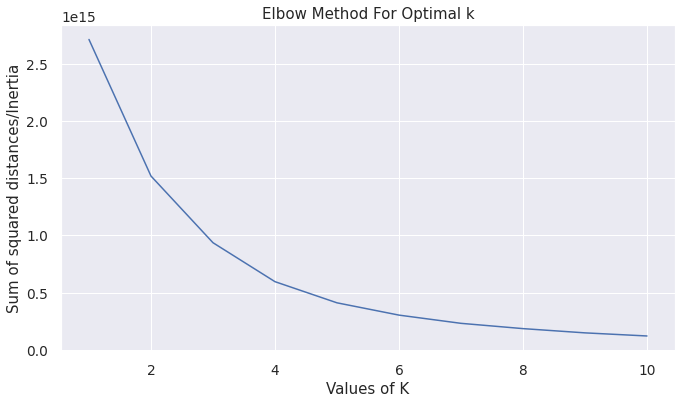

In [263]:
sum_of_squared_distances = []
K = range(1,11)
for num_clusters in K :
 kmeans = KMeans(n_clusters=num_clusters)
 kmeans.fit(X)
 sum_of_squared_distances.append(kmeans.inertia_)
plt.plot(K, sum_of_squared_distances, 'bx-')
plt.xlabel('Values of K') 
plt.ylabel('Sum of squared distances/Inertia') 
plt.title('Elbow Method For Optimal k')
plt.show()

From the graph we can observe that at 4 the line bends so we will be chosing our no of clusters as 4 according to the elbow method

In [264]:
cluster_pipeline = Pipeline([('scaler', StandardScaler()), ('kmeans', KMeans(n_clusters=4, verbose=2))])
cluster_pipeline.fit(X)

Initialization complete
Iteration 0, inertia 2750699.6234728205
Iteration 1, inertia 1800787.817187083
Iteration 2, inertia 1746841.456491265
Iteration 3, inertia 1731117.2310270253
Iteration 4, inertia 1724666.3433001428
Iteration 5, inertia 1722396.3827541587
Iteration 6, inertia 1721541.6329425233
Iteration 7, inertia 1721181.811052116
Iteration 8, inertia 1720993.046864163
Iteration 9, inertia 1720879.6785967387
Iteration 10, inertia 1720806.9291798295
Iteration 11, inertia 1720750.842813571
Iteration 12, inertia 1720710.5382429224
Iteration 13, inertia 1720670.7278644412
Iteration 14, inertia 1720627.9115176927
Iteration 15, inertia 1720572.9542092215
Iteration 16, inertia 1720502.4386815804
Iteration 17, inertia 1720416.07355475
Iteration 18, inertia 1720300.0062522693
Iteration 19, inertia 1720124.5353321852
Iteration 20, inertia 1719832.5466245622
Iteration 21, inertia 1719245.7450941186
Iteration 22, inertia 1717976.3096999489
Iteration 23, inertia 1714652.378598372
Iteration 

Pipeline(steps=[('scaler', StandardScaler()),
                ('kmeans', KMeans(n_clusters=4, verbose=2))])

In [265]:
cluster_labels = cluster_pipeline.predict(X)
df['cluster'] = cluster_labels
df['cluster'].value_counts()

3    85516
0    67925
1    11838
2     5374
Name: cluster, dtype: int64

We can reduce dimentionality using Principal Component Analysis, fit and visualize our data using a Plotly hover plot.

In [266]:
pca_pipeline = Pipeline([('scaler', StandardScaler()), ('PCA', PCA(n_components=2))])
song_embedding = pca_pipeline.fit_transform(X)
projection = pd.DataFrame(columns=['x', 'y'], data=song_embedding)
projection['title'] = df['name']
projection['artist'] = df['artists']
projection['cluster'] = df['cluster']
projection

,x,y,title,artist,cluster
0,4.187860,2.086750,"Piano Concerto No. 3 in D Minor, Op. 30: III. ...","['Sergei Rachmaninoff', 'James Levine', 'Berli...",0
1,0.708361,-3.326423,Clancy Lowered the Boom,['Dennis Day'],0
2,3.741820,1.508756,Gati Bali,['KHP Kridhamardawa Karaton Ngayogyakarta Hadi...,0
3,2.168019,0.463922,Danny Boy,['Frank Parker'],0
4,2.140164,-0.167271,When Irish Eyes Are Smiling,['Phil Regan'],0
...,...,...,...,...,...
170648,-2.699394,0.515888,China,"['Anuel AA', 'Daddy Yankee', 'KAROL G', 'Ozuna...",3
170649,-2.494023,0.195812,Halloweenie III: Seven Days,['Ashnikko'],3
170650,-2.681807,0.576893,AYA,['MAMAMOO'],3
170651,-2.170282,-0.858658,Darkness,['Eminem'],1


In [267]:
fig = px.scatter(projection, x='x', y='y', color='cluster', hover_data=['x', 'y', 'title', 'artist'])
fig.show()

We can proceed to build a content-based recommendation system, however let's repeat the process with two clusters and visualize our results to see if we can build a clasifier and identify the model's most important features.

In [268]:
cluster_pipeline2 = Pipeline([('scaler', StandardScaler()), ('kmeans', KMeans(n_clusters=2, verbose=2))])
cluster_pipeline2.fit(X)

Initialization complete
Iteration 0, inertia 3162265.09083868
Iteration 1, inertia 1981915.1851670742
Iteration 2, inertia 1959313.1662184135
Iteration 3, inertia 1954774.2095810464
Iteration 4, inertia 1953871.0091772655
Iteration 5, inertia 1953638.2380704046
Iteration 6, inertia 1953572.3390628782
Iteration 7, inertia 1953555.6386743358
Converged at iteration 7: center shift 2.881282338119889e-05 within tolerance 0.00010000000000000822.
Initialization complete
Iteration 0, inertia 2874305.928794915
Iteration 1, inertia 2070651.2163279061
Iteration 2, inertia 1962287.8028994938
Iteration 3, inertia 1954135.2552903225
Iteration 4, inertia 1953598.8062580063
Iteration 5, inertia 1953554.2743059443
Converged at iteration 5: center shift 3.3906502319106954e-05 within tolerance 0.00010000000000000822.
Initialization complete
Iteration 0, inertia 2633224.200709232
Iteration 1, inertia 2113455.970780842
Iteration 2, inertia 1999780.285126919
Iteration 3, inertia 1965430.3245597552
Iteration

Pipeline(steps=[('scaler', StandardScaler()),
                ('kmeans', KMeans(n_clusters=2, verbose=2))])

In [269]:
cluster_labels2 = cluster_pipeline2.predict(X)
df['cluster2'] = cluster_labels2
df['cluster2'].value_counts()

1    93535
0    77118
Name: cluster2, dtype: int64

In [270]:
pca_pipeline2 = Pipeline([('scaler', StandardScaler()), ('PCA', PCA(n_components=2))])
song_embedding2 = pca_pipeline2.fit_transform(X)
projection2 = pd.DataFrame(columns=['x', 'y'], data=song_embedding2)
projection2['title'] = df['name']
projection2['artist'] = df['artists']
projection2['cluster2'] = df['cluster2']
projection2

,x,y,title,artist,cluster2
0,4.187824,2.086474,"Piano Concerto No. 3 in D Minor, Op. 30: III. ...","['Sergei Rachmaninoff', 'James Levine', 'Berli...",0
1,0.708357,-3.326398,Clancy Lowered the Boom,['Dennis Day'],0
2,3.741779,1.508646,Gati Bali,['KHP Kridhamardawa Karaton Ngayogyakarta Hadi...,0
3,2.167983,0.463756,Danny Boy,['Frank Parker'],0
4,2.140121,-0.167420,When Irish Eyes Are Smiling,['Phil Regan'],0
...,...,...,...,...,...
170648,-2.699384,0.516045,China,"['Anuel AA', 'Daddy Yankee', 'KAROL G', 'Ozuna...",1
170649,-2.494002,0.195983,Halloweenie III: Seven Days,['Ashnikko'],1
170650,-2.681781,0.577159,AYA,['MAMAMOO'],1
170651,-2.170292,-0.858667,Darkness,['Eminem'],1


In [294]:
fig2 = px.scatter(projection2, x='x', y='y', color='cluster2', hover_data=['x', 'y', 'title', 'artist'])
fig2.show()

While our sample sizes are imbalanced, our cluster on the positive x-axis remains similar. A binary classification model focusing on accuracy can pinpoint which audio features are most important.

In [275]:
predictor_x = df.drop(columns=['name', 'artists', 'release_date', 'tempo', 'cluster', 'cluster2','id','decade','artists_song'], axis=1)
predictor_y = df.cluster2

Function to print the precision score, F1 score which are the important factors to analyze the accuracy of a model

In [276]:
def print_metrics(labels, preds):
    
    # Function to easily print results of training and test metrics
    print("Precision Score: {}".format(precision_score(labels, preds)))
    print("Recall Score: {}".format(recall_score(labels, preds)))
    print("Accuracy Score: {}".format(accuracy_score(labels, preds)))
    print("F1 Score: {}".format(f1_score(labels, preds)))

# **Train Valid Test Split data**

We split our data in the form of 75/25 ratio

In [277]:
# Creating train and test sets, scaling and using SMOTE to adjust for imbalanced samples
X_train, X_test, y_train, y_test = train_test_split(predictor_x, predictor_y, test_size=.25,  random_state=42)


scaling and using SMOTE to adjust for imbalanced samples

In [278]:
scaler = StandardScaler()
smote = SMOTE()

Using Logistic Regression in pipeline to fit resampled sets

In [279]:
logreg = LogisticRegression(fit_intercept=False, solver='liblinear')
X_train_resampled, y_train_resampled = smote.fit_resample(X_train, y_train)
pipeline = make_pipeline(scaler, smote, logreg)
pipeline.fit(X_train_resampled, y_train_resampled)
train_pred = pipeline.predict(X_train_resampled)
test_pred = pipeline.predict(X_test)

 ROC AUC score and classification metrics followed by visualized confusion matrix

In [291]:
train_score = roc_auc_score(y_train_resampled, train_pred)
test_score = roc_auc_score(y_test, test_pred)
print("Training Score: ", train_score)
print("Test Score: ", test_score)

Training Score:  0.9846919168196763
Test Score:  0.9839923547043209


The outputs for the model

In [292]:
print("Training Metrics")
print(print_metrics(y_train_resampled, train_pred))
print('\n')
print("Testing Metrics")
print(print_metrics(y_test, test_pred))

Training Metrics
Precision Score: 0.9852098828759511
Recall Score: 0.9841581621760109
Accuracy Score: 0.9846919168196764
F1 Score: 0.9846837416956828
None


Testing Metrics
Precision Score: 0.9858119437637044
Recall Score: 0.9850073030329066
Accuracy Score: 0.9840849428089256
F1 Score: 0.9854094591400392
None


We check for feature importance and see which ones are the ones which have a larger impact

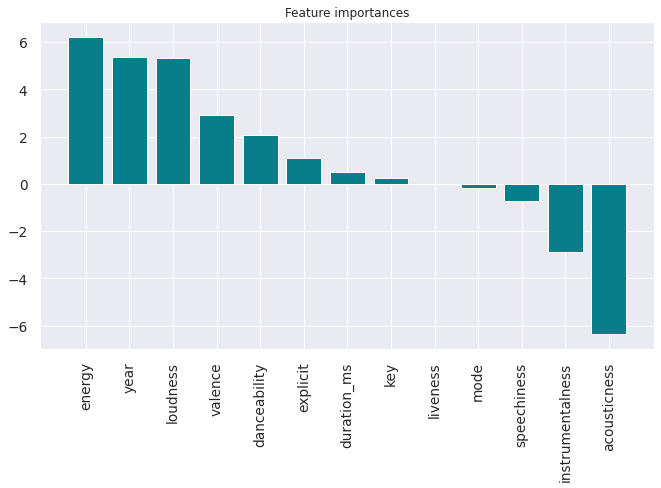

In [293]:
importances = pd.DataFrame(data={
    'Attribute': X_train.columns,
    'Importance': logreg.coef_[0]
})
importances = importances.sort_values(by='Importance', ascending=False)
plt.bar(x=importances['Attribute'], height=importances['Importance'], color='#087E8B')
plt.title('Feature importances', size=12)
plt.xticks(rotation='vertical')
plt.show()

In [ ]:
x = data[['danceability', 'energy', 'loudness',	'speechiness',	'acousticness',	'instrumentalness',	'liveness',	'valence',	'tempo'	]]
from sklearn import preprocessing

# scale the data for better results
x_scaled = preprocessing.scale(x)

In [ ]:
from sklearn import preprocessing

# scale the data for better results
x_scaled = preprocessing.scale(x)

In [ ]:
# from sklearn.cluster import AgglomerativeClustering
# model_agg = AgglomerativeClustering(n_clusters=4)
# model_agg.fit(x_scaled)
# data['agg']=model_agg.fit_predict(x_scaled)

Pip install spotipy pip package to use the Spotify API and use the functions accordingly and authenticate the profile

In [ ]:
 !pip install spotipy

# **Building the recommendation system**


*   Based on the analysis and visualizations, it’s clear that similar genres tend to have data points that are located close to each other while similar types of songs are also clustered together.
*   This observation makes perfect sense. Similar genres will sound similar and will come from similar time periods while the same can be said for songs within those genres. We can use this idea to build a recommendation system by taking the data points of the songs a user has listened to and recommending songs corresponding to nearby data points.



### **Spotify Authentication**

Using the Spotify API we authenticate using client id and client secret which we will be getting from the spotify developer portal. Once authenticated we then retrieve the songs of that particular user and then recommend songs according to that

In [ ]:
import spotipy
from spotipy.oauth2 import SpotifyClientCredentials
from collections import defaultdict

sp = spotipy.Spotify(auth_manager=SpotifyClientCredentials(client_id="46c6b4ce51f842a1a04303347fe27f24",
                                                           client_secret="d9814f4a3d4340acb15913977e2c1656"))

def find_song(name, year):
    song_data = defaultdict()
    results = sp.search(q= 'track: {} year: {}'.format(name,year), limit=1)
    if results['tracks']['items'] == []:
        return None

    results = results['tracks']['items'][0]
    track_id = results['id']
    audio_features = sp.audio_features(track_id)[0]

    song_data['name'] = [name]
    song_data['year'] = [year]
    song_data['explicit'] = [int(results['explicit'])]
    song_data['duration_ms'] = [results['duration_ms']]
    song_data['popularity'] = [results['popularity']]

    for key, value in audio_features.items():
        song_data[key] = value

    return pd.DataFrame(song_data)

# **Content-based recommendation**

Content-based filtering methods are based on a description of the item and a profile of the user's preferences. Content-based recommenders treat recommendation as a user-specific classification problem and learn a classifier for the user's likes and dislikes based on an item's features.

Basically, these methods use an item profile (i.e., a set of discrete attributes and characteristics) characterizing the item within the system. To abstract the features of the items in the system, an item presentation algorithm is applied. A widely used algorithm is the vector space representation.

Such a content-based recommendation system makes recommendations based on the "proximity" of an item's vector to the vector of an item that the user likes. Those items whose vector representations are close to the vector representation of an item already liked by the user are recommended.

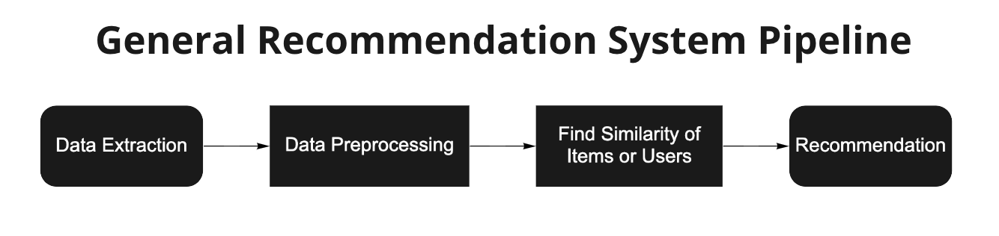

What are recommendation systems?

Recommender systems are active information filtering systems which personalize the information coming to a user based on their interests, relevance of the information etc. Recommender systems are used widely for recommending movies, articles, restaurants, places to visit, items to buy etc.

Simply put, recommendation systems "recommend" personalized content on the basis of user’s past/current preference to improve the user experience. Broadly, there are two types of recommendation systems – Content-based & Collaborative filtering based.

YouTube sugesting relevant videos to viewers based on their previous browsing history, as well as LinkedIn suggesting users to connect with other users they may know, are instances of recommendation systems in action.

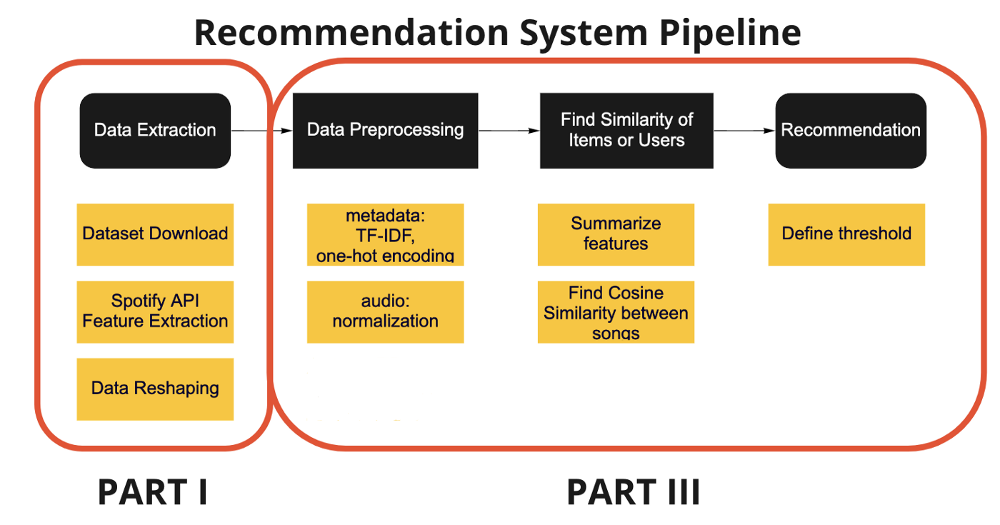

In [ ]:
from collections import defaultdict
from sklearn.metrics import euclidean_distances
from scipy.spatial.distance import cdist
import difflib

number_cols = ['valence', 'year', 'acousticness', 'danceability', 'duration_ms', 'energy', 'explicit',
 'instrumentalness', 'key', 'liveness', 'loudness', 'mode', 'speechiness', 'tempo']


def get_song_data(song, spotify_data):
    
    try:
        song_data = spotify_data[(spotify_data['name'] == song['name']) 
                                & (spotify_data['year'] == song['year'])].iloc[0]
        return song_data
    
    except IndexError:
        return find_song(song['name'], song['year'])
        

def get_mean_vector(song_list, spotify_data):
    
    song_vectors = []
    
    for song in song_list:
        song_data = get_song_data(song, spotify_data)
        if song_data is None:
            print('Warning: {} does not exist in Spotify or in database'.format(song['name']))
            continue
        song_vector = song_data[number_cols].values
        song_vectors.append(song_vector)  
    
    song_matrix = np.array(list(song_vectors))
    return np.mean(song_matrix, axis=0)


def flatten_dict_list(dict_list):
    
    flattened_dict = defaultdict()
    for key in dict_list[0].keys():
        flattened_dict[key] = []
    
    for dictionary in dict_list:
        for key, value in dictionary.items():
            flattened_dict[key].append(value)
            
    return flattened_dict


def recommend_songs( song_list, spotify_data, n_songs=10):
    
    metadata_cols = ['name', 'year', 'artists']
    song_dict = flatten_dict_list(song_list)
    
    song_center = get_mean_vector(song_list, spotify_data)
    scaler = pca_pipeline.steps[0][1]
    scaled_data = scaler.transform(spotify_data[number_cols])
    scaled_song_center = scaler.transform(song_center.reshape(1, -1))
    distances = cdist(scaled_song_center, scaled_data, 'cosine')
    index = list(np.argsort(distances)[:, :n_songs][0])
    
    rec_songs = spotify_data.iloc[index]
    rec_songs = rec_songs[~rec_songs['name'].isin(song_dict['name'])]
    return rec_songs[metadata_cols].to_dict(orient='records')

After we build the model then we pass few songs and then see how they are recommended basing on our dataset

In [290]:
recommend_songs([{'name': 'Come As You Are', 'year':1991},
                {'name': 'Smells Like Teen Spirit', 'year': 1991},
                {'name': 'Lithium', 'year': 1992},
                {'name': 'All Apologies', 'year': 1993},
                {'name': 'Stay Away', 'year': 1993}],  data)

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:33: VisibleDeprecationWarning:

Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.

/usr/local/lib/python3.7/dist-packages/sklearn/base.py:451: UserWarning:

X does not have valid feature names, but StandardScaler was fitted with feature names



[{'artists': "['Dexter Freebish']", 'name': 'Leaving Town', 'year': 2000},
 {'artists': "['Godsmack']", 'name': 'No Rest For The Wicked', 'year': 2006},
 {'artists': "['Rascal Flatts']",
  'name': 'Life is a Highway - From "Cars"',
  'year': 2009},
 {'artists': "['Bad English']", 'name': 'Best of What I Got', 'year': 1989},
 {'artists': "['The Wallflowers']", 'name': 'Bleeders', 'year': 1996},
 {'artists': "['Social Distortion']", 'name': '99 To Life', 'year': 1992},
 {'artists': "['John Hiatt']", 'name': 'Perfectly Good Guitar', 'year': 1993},
 {'artists': "['Los Fugitivos']", 'name': 'Corazón Mágico', 'year': 1995},
 {'artists': "['Metallica']", 'name': 'Of Wolf And Man', 'year': 1991},
 {'artists': "['Danger Danger']", 'name': "Don't Walk Away", 'year': 1989}]

As we have observed that we are using the pipelined data which we have got from the clustered data we see that we have got a list of songs along with their artists and songs when we listen we can observe the similarity exists with the songs

# **Conclusion**

We have observed that after performing a thorough Exploratory data analysis we can then get the necessary features for our modelling. Certain plots are shown as to have more insights into the dataset and when you have a glance can have a full knowledge about the dataset. After we perform KNN Clustering on the data we have observed that we achieve a **98.5%** accuracy. Once pipeline the clustered data we then build a content based recommendation system using the spotify API to compare the songs and retrieve their audio features so that we can get the results from the existing dataset where the recommended songs displays with their necessary details.

# **References**


*   https://benanne.github.io/2014/08/05/spotify-cnns.html
*   https://medium.com/analytics-vidhya/pca-vs-t-sne-17bcd882bf3d#:~:text=t%2DSNE(T%2D%20distributed%20Stochastic%20Neighbor%20Embedding)%3A&text=One%20of%20the%20most%20major,large%20pairwise%20distance%20maximize%20variance.&text=It%20takes%20a%20set%20of,it%20into%20low%20dimensional%20data.

*   https://towardsdatascience.com/k-means-clustering-using-spotify-song-features-9eb7d53d105c
*   https://scholarworks.gvsu.edu/honorsprojects/891/


*   https://www.music-tomorrow.com/blog/how-spotify-recommendation-system-works-a-complete-guide-2022#:~:text=%22We%20can%20understand%20songs%20to,recommend%20song%20Z%20to%20them.
*   https://blogs.commons.georgetown.edu/cctp-607-spring2019/2019/05/06/music-to-my-ears-de-blackboxing-spotifys-recommendation-algorithm/


*   https://exchange.scale.com/public/blogs/inside-the-content-recommendation-engine-at-the-heart-of-spotify










# **MIT License**

Copyright (c) 2022 Sai Raghavendra

Permission is hereby granted, free of charge, to any person obtaining a copy
of this software and associated documentation files (the "Software"), to deal
in the Software without restriction, including without limitation the rights
to use, copy, modify, merge, publish, distribute, sublicense, and/or sell
copies of the Software, and to permit persons to whom the Software is
furnished to do so, subject to the following conditions:

The above copyright notice and this permission notice shall be included in all
copies or substantial portions of the Software.

THE SOFTWARE IS PROVIDED "AS IS", WITHOUT WARRANTY OF ANY KIND, EXPRESS OR
IMPLIED, INCLUDING BUT NOT LIMITED TO THE WARRANTIES OF MERCHANTABILITY,
FITNESS FOR A PARTICULAR PURPOSE AND NONINFRINGEMENT. IN NO EVENT SHALL THE
AUTHORS OR COPYRIGHT HOLDERS BE LIABLE FOR ANY CLAIM, DAMAGES OR OTHER
LIABILITY, WHETHER IN AN ACTION OF CONTRACT, TORT OR OTHERWISE, ARISING FROM,
OUT OF OR IN CONNECTION WITH THE SOFTWARE OR THE USE OR OTHER DEALINGS IN THE
SOFTWARE.